<a href="https://colab.research.google.com/github/munikumar229/es335-24-fall-assignment-2/blob/master/task2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Task 2

1. Image Reconstruction - Choose any image you like. Use Random Fourier Features (RFF) and Linear Regression to learn the mapping from the image coordinates (X,Y) to the pixel colors (R,G,B). Here, (X,Y) represents the coordinates of the pixels, and (R,G,B) represents the color values at those coordinates. Display both the original image and the reconstructed image. Also, calculate and report the Root Mean Squared Error (MSE) and Peak Signal-to-Noise Ratio (PSNR) between the original and reconstructed images.

In [ ]:
import torchvision
import torchvision.transforms as transforms


# Read in a image from torchvision
img = torchvision.io.read_image("cat.jpg")
print(img.shape)

/opt/homebrew/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


torch.Size([3, 4243, 6362])


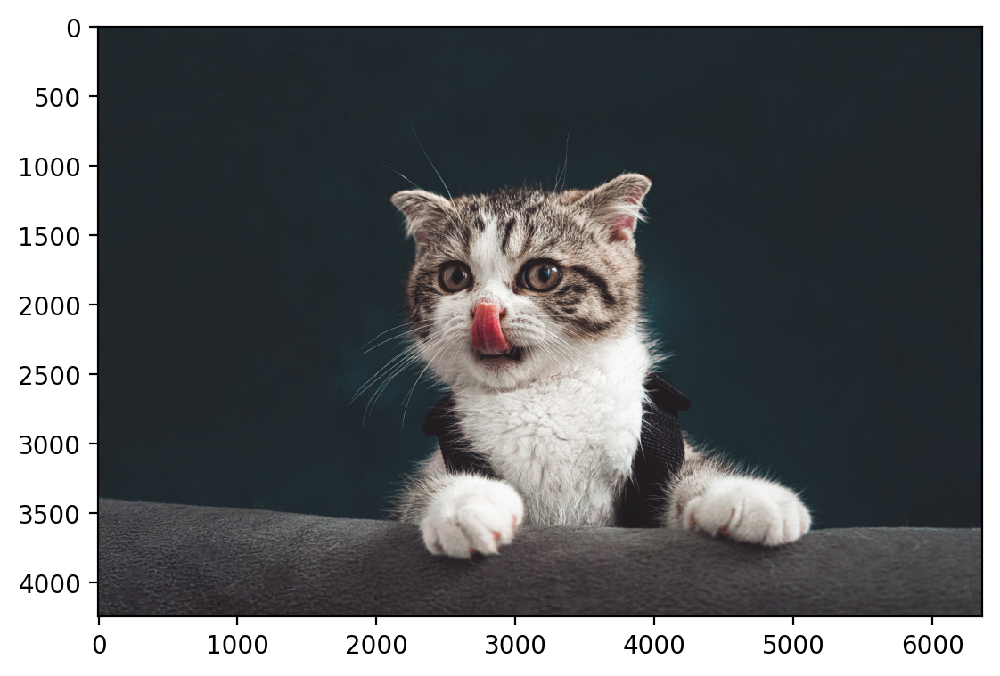

In [ ]:
plt.imshow(rearrange(img, 'c h w -> h w c').numpy())


In [ ]:
from sklearn import preprocessing

scaler_img = preprocessing.MinMaxScaler().fit(img.reshape(-1, 1))
scaler_img

MinMaxScaler()

In [ ]:
img_scaled = scaler_img.transform(img.reshape(-1, 1)).reshape(img.shape)
img_scaled.shape

img_scaled = torch.tensor(img_scaled)

In [ ]:
img_scaled = img_scaled.to(device)
img_scaled

tensor([[[0.1059, 0.1020, 0.1412,  ..., 0.0941, 0.1216, 0.1176],
         [0.1451, 0.1020, 0.1020,  ..., 0.0941, 0.1451, 0.1412],
         [0.1333, 0.1333, 0.1490,  ..., 0.1176, 0.1216, 0.1176],
         ...,
         [0.1725, 0.2706, 0.2157,  ..., 0.2196, 0.1451, 0.1765],
         [0.1725, 0.2157, 0.1765,  ..., 0.3020, 0.2235, 0.2549],
         [0.1922, 0.1882, 0.2196,  ..., 0.3137, 0.2078, 0.2392]],

        [[0.1412, 0.1373, 0.1765,  ..., 0.1373, 0.1647, 0.1608],
         [0.1804, 0.1373, 0.1373,  ..., 0.1373, 0.1882, 0.1843],
         [0.1608, 0.1608, 0.1765,  ..., 0.1569, 0.1608, 0.1569],
         ...,
         [0.1647, 0.2627, 0.2078,  ..., 0.2118, 0.1373, 0.1686],
         [0.1647, 0.2078, 0.1686,  ..., 0.2941, 0.2157, 0.2471],
         [0.1843, 0.1804, 0.2118,  ..., 0.3059, 0.2000, 0.2314]],

        [[0.1608, 0.1569, 0.1961,  ..., 0.1451, 0.1725, 0.1686],
         [0.2000, 0.1569, 0.1569,  ..., 0.1451, 0.1961, 0.1922],
         [0.1843, 0.1843, 0.2000,  ..., 0.1647, 0.1686, 0.

In [ ]:
crop = torchvision.transforms.functional.crop(img_scaled.cpu(), 1750, 2500, 300, 300)
crop.shape

torch.Size([3, 300, 300])

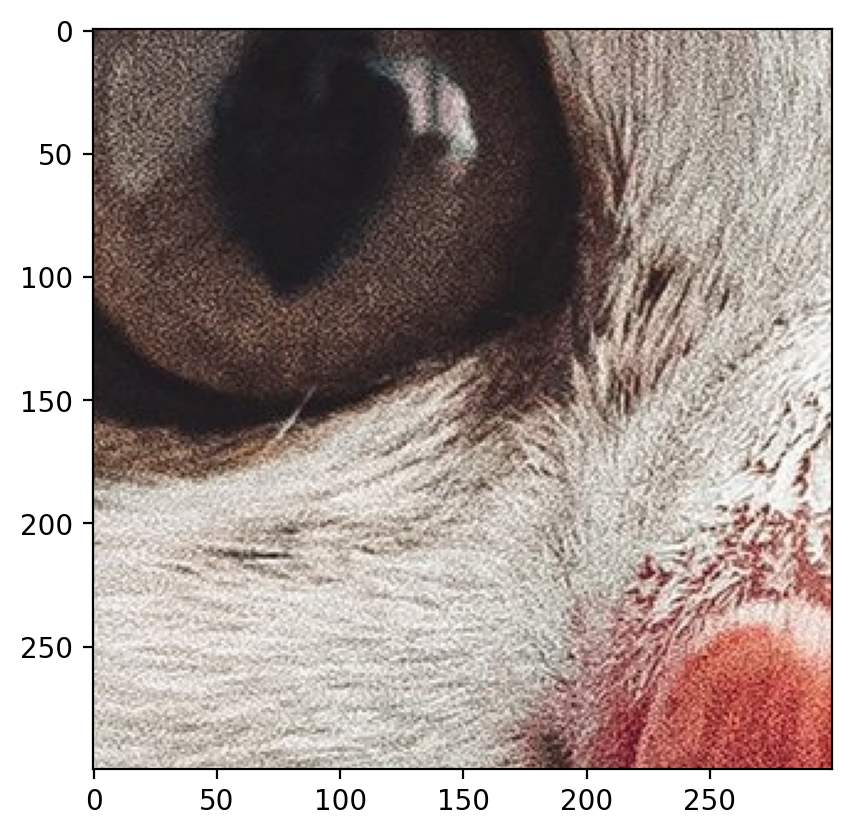

In [ ]:
plt.imshow(rearrange(crop, 'c h w -> h w c').cpu().numpy())


In [ ]:
crop = crop.to(device)


In [ ]:
# Get the dimensions of the image tensor
num_channels, height, width = crop.shape
print(num_channels, height, width)

3 300 300


In [ ]:
num_channels, height, width = 2, 3, 4


# Create a 2D grid of (x,y) coordinates
w_coords = torch.arange(width).repeat(height, 1)
h_coords = torch.arange(height).repeat(width, 1).t()
w_coords = w_coords.reshape(-1)
h_coords = h_coords.reshape(-1)

# Combine the x and y coordinates into a single tensor
X = torch.stack([h_coords, w_coords], dim=1).float()

In [ ]:
X.shape

torch.Size([12, 2])

In [ ]:
def create_coordinate_map(img):
    """
    img: torch.Tensor of shape (num_channels, height, width)

    return: tuple of torch.Tensor of shape (height * width, 2) and torch.Tensor of shape (height * width, num_channels)
    """

    num_channels, height, width = img.shape

    # Create a 2D grid of (x,y) coordinates (h, w)
    # width values change faster than height values
    w_coords = torch.arange(width).repeat(height, 1)
    h_coords = torch.arange(height).repeat(width, 1).t()
    w_coords = w_coords.reshape(-1)
    h_coords = h_coords.reshape(-1)

    # Combine the x and y coordinates into a single tensor
    X = torch.stack([h_coords, w_coords], dim=1).float()

    # Move X to GPU if available
    X = X.to(device)

    # Reshape the image to (h * w, num_channels)
    Y = rearrange(img, 'c h w -> (h w) c').float()
    return X, Y

In [ ]:
cat_X, cat_Y = create_coordinate_map(crop)

cat_X.shape, cat_Y.shape

(torch.Size([90000, 2]), torch.Size([90000, 3]))

In [ ]:
# MinMaxScaler from -1 to 1
scaler_X = preprocessing.MinMaxScaler(feature_range=(-1, 1)).fit(cat_X.cpu())

# Scale the X coordinates
cat_X_scaled = scaler_X.transform(cat_X.cpu())

# Move the scaled X coordinates to the GPU
cat_X_scaled = torch.tensor(cat_X_scaled).to(device)

# Set to dtype float32
cat_X_scaled = cat_X_scaled.float()

In [ ]:
class LinearModel(nn.Module):
    def __init__(self, in_features, out_features):
        super(LinearModel, self).__init__()
        self.linear = nn.Linear(in_features, out_features)

    def forward(self, x):
        return self.linear(x)


In [ ]:
net = LinearModel(2, 3)
net.to(device)


LinearModel(
  (linear): Linear(in_features=2, out_features=3, bias=True)
)

In [ ]:
def train(net, lr, X, Y, epochs, verbose=True):
    """
    net: torch.nn.Module
    lr: float
    X: torch.Tensor of shape (num_samples, 2)
    Y: torch.Tensor of shape (num_samples, 3)
    """

    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(net.parameters(), lr=lr)
    for epoch in range(epochs):
        optimizer.zero_grad()
        outputs = net(X)


        loss = criterion(outputs, Y)
        loss.backward()
        optimizer.step()
        if verbose and epoch % 100 == 0:
            print(f"Epoch {epoch} loss: {loss.item():.6f}")
    return loss.item()

In [ ]:
train(net, 0.01, cat_X_scaled, cat_Y, 1000)

Epoch 0 loss: 0.707875
Epoch 100 loss: 0.073501
Epoch 200 loss: 0.051437
Epoch 300 loss: 0.051364
Epoch 400 loss: 0.051364
Epoch 500 loss: 0.051364
Epoch 600 loss: 0.051364
Epoch 700 loss: 0.051364
Epoch 800 loss: 0.051364
Epoch 900 loss: 0.051364


0.05136408656835556

In [ ]:
def plot_reconstructed_and_original_image(original_img, net, X, title=""):
    """
    net: torch.nn.Module
    X: torch.Tensor of shape (num_samples, 2)
    Y: torch.Tensor of shape (num_samples, 3)
    """
    num_channels, height, width = original_img.shape
    net.eval()
    with torch.no_grad():
        outputs = net(X)
        outputs = outputs.reshape(height, width, num_channels)
        #outputs = outputs.permute(1, 2, 0)
    fig = plt.figure(figsize=(6, 4))
    gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1])

    ax0 = plt.subplot(gs[0])
    ax1 = plt.subplot(gs[1])

    ax0.imshow(outputs.cpu())
    ax0.set_title("Reconstructed Image")


    ax1.imshow(original_img.cpu().permute(1, 2, 0))
    ax1.set_title("Original Image")

    for a in [ax0, ax1]:
        a.axis("off")


    fig.suptitle(title, y=0.9)
    plt.tight_layout()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


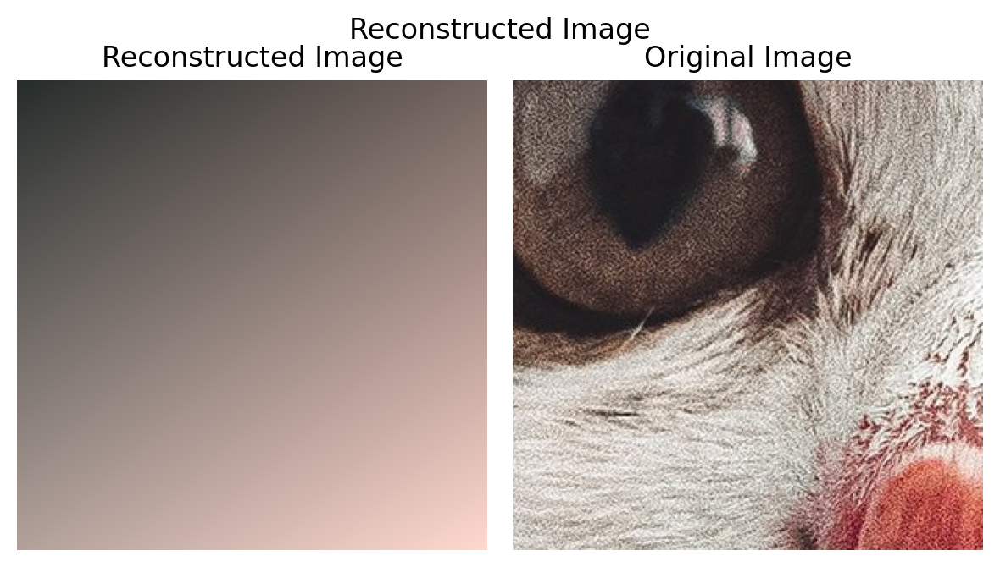

In [ ]:
plot_reconstructed_and_original_image(crop, net, cat_X_scaled, title="Reconstructed Image")

In [ ]:
# create RFF features
def create_rff_features(X, num_features, sigma):
    from sklearn.kernel_approximation import RBFSampler
    rff = RBFSampler(n_components=num_features, gamma=1/(2 * sigma**2))
    X = X.cpu().numpy()
    X = rff.fit_transform(X)
    return torch.tensor(X, dtype=torch.float32).to("mps")


In [ ]:
X_rff = create_rff_features(cat_X_scaled, 10000, 0.008)

In [ ]:
X_rff.shape

torch.Size([90000, 10000])

In [ ]:
net = LinearModel(X_rff.shape[1], 3)
net.to("mps")

train(net, 0.005, X_rff.to("mps"), cat_Y.to("mps"), 1800)

Epoch 0 loss: 0.345814
Epoch 100 loss: 0.077489
Epoch 200 loss: 0.055248
Epoch 300 loss: 0.049812
Epoch 400 loss: 0.045547
Epoch 500 loss: 0.041934
Epoch 600 loss: 0.038814
Epoch 700 loss: 0.036096
Epoch 800 loss: 0.033715
Epoch 900 loss: 0.031621
Epoch 1000 loss: 0.029777
Epoch 1100 loss: 0.028150
Epoch 1200 loss: 0.026713
Epoch 1300 loss: 0.025442
Epoch 1400 loss: 0.024317
Epoch 1500 loss: 0.023320
Epoch 1600 loss: 0.022438
Epoch 1700 loss: 0.021656


0.02096845954656601

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


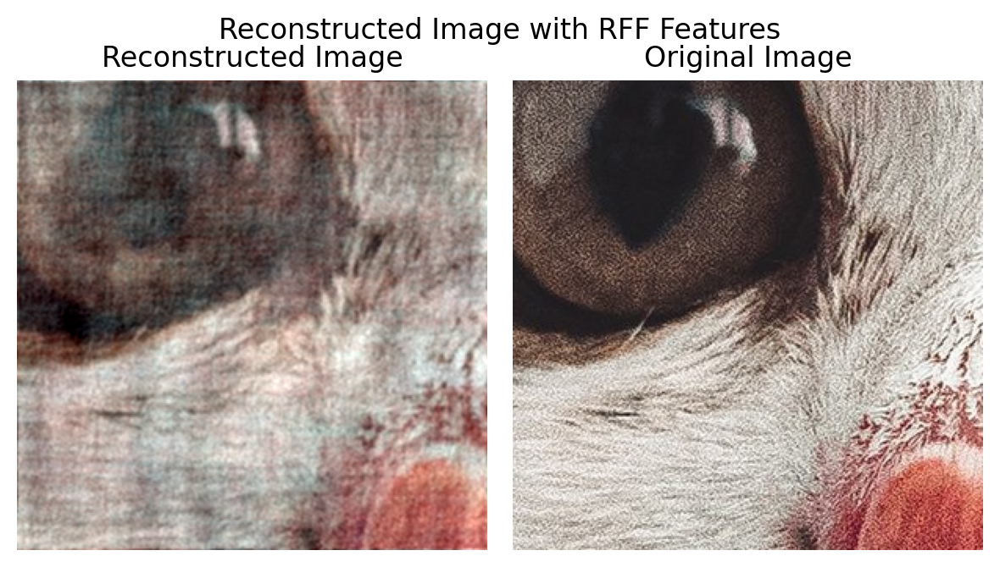

In [ ]:
plot_reconstructed_and_original_image(crop, net, X_rff, title="Reconstructed Image with RFF Features")

2. Audio Reconstruction - Pick a 5-second audio sample of your liking. Use Random Fourier Features (RFF) and Linear Regression to learn the mapping from time (t) to amplitude (A), where t is the time point, and A is the audio amplitude at that time. Play the reconstructed audio and the original audio to demonstrate reconstruction. Calculate the Root Mean Squared Error (RMSE) and Signal-to-Noise Ratio (SNR) to evaluate the reconstruction.

In [ ]:
import soundfile

%matplotlib inline
%config InlineBackend.figure_format = "retina"

if torch.backends.mps.is_available():
    device = torch.device("mps")
elif torch.cuda.is_available():
    device = torch.device("cuda")
else:
    device = torch.device("cpu")

print(device)

mps


In [ ]:
from IPython.display import Audio
Audio('bach-toccata-and-fugue-in-d-minor-(frederik-magle).mp3')

In [ ]:
import torchaudio
audio, sr = torchaudio.load('bach-toccata-and-fugue-in-d-minor-(frederik-magle).mp3')

In [ ]:
sr

44100

In [ ]:
8*44100

352800

In [ ]:
audio = audio[:,:8*sr]

In [ ]:
print(audio.shape)
audio = audio[0]
print(audio.shape)

torch.Size([2, 352800])
torch.Size([352800])


In [ ]:
tm = audio.shape[0] / sr
print(f"Audio length: {tm} seconds")

Audio length: 8.0 seconds


In [ ]:
audio

tensor([ 0.0000e+00, -8.3633e-14, -1.3577e-15,  ...,  2.1062e-02,
         2.3123e-02,  2.2654e-02])

In [ ]:
def audio_plot(audio, sr, clr, tl):
    plt.figure(figsize=(15, 4))
    plt.plot(audio, color = clr, alpha = 0.7)
    plt.xticks(np.arange(0, audio.shape[0], sr), np.arange(0, audio.shape[0] / sr, 1))
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.title(tl)
    plt.grid()
    plt.show()

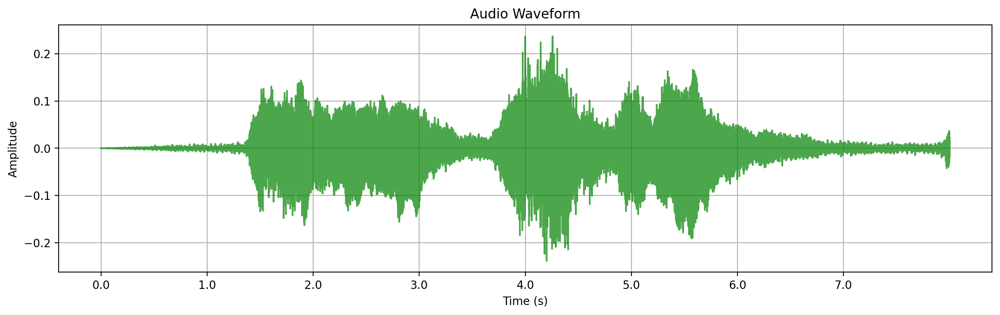

In [ ]:
audio_plot(audio, sr, 'green', 'Audio Waveform')

In [ ]:
X = torch.arange(0, len(audio)).unsqueeze(1).float()
X = X / X.max() * 200 - 100
print(X.shape)
print(X)

torch.Size([352800, 1])
tensor([[-100.0000],
        [ -99.9994],
        [ -99.9989],
        ...,
        [  99.9989],
        [  99.9994],
        [ 100.0000]])


In [ ]:
Audio(audio, rate = sr)

In [ ]:
from sklearn.kernel_approximation import RBFSampler

def create_rff_features(X, num_features, sigma):
    # Set a random state to the sampler for repoducibility
    rff = RBFSampler(n_components = num_features, gamma = 1 / (2 * sigma**2), random_state = 13)
    X = X.cpu().numpy()
    X = rff.fit_transform(X)
    return torch.tensor(X, dtype = torch.float32)

In [ ]:
num_features = 5000
sigma = 0.008

X_rff = create_rff_features(X, num_features, sigma)
print(X_rff.shape)
print(X_rff)

torch.Size([352800, 5000])
tensor([[ 8.8322e-03, -1.7875e-02, -1.9026e-02,  ..., -1.9567e-02,
          7.0636e-03, -5.3269e-03],
        [ 7.9099e-03, -1.8323e-02, -1.9006e-02,  ..., -1.9627e-02,
          7.6177e-03, -6.2800e-03],
        [ 6.9673e-03, -1.8727e-02, -1.8987e-02,  ..., -1.9682e-02,
          8.1740e-03, -7.2176e-03],
        ...,
        [-9.2205e-03, -1.9023e-02, -1.4493e-02,  ...,  6.2409e-03,
         -6.7576e-04, -1.3416e-02],
        [-8.3433e-03, -1.8678e-02, -1.4451e-02,  ...,  6.5140e-03,
         -9.9714e-05, -1.4124e-02],
        [-7.3918e-03, -1.8259e-02, -1.4407e-02,  ...,  6.8040e-03,
          5.1546e-04, -1.4825e-02]])


In [ ]:
from sklearn.linear_model import LinearRegression

model = LinearRegression()
model.fit(X_rff.numpy(), audio)

pred_audio = model.predict(X_rff.numpy())

In [ ]:
print(f"Root mean squared Error : {(np.mean((audio - pred_audio)**2))**0.5}")
signal_power = np.mean(audio**2)
noise_power = np.mean((pred_audio - audio)**2)
snr = 10 * np.log10(signal_power / noise_power)
print(f"SNR : {snr}")

Root mean squared Error : 0.029786396196227118
SNR : 0.9272651374340057


In [ ]:
import joblib
joblib.dump(model, 'model.pkl')
model = joblib.load('model.pkl')

import soundfile as sf
sf.write('pred_audio.wav', pred_audio, sr)

In [ ]:
np.linalg.norm(pred_audio - audio.numpy())

17.692186

In [ ]:
Audio(pred_audio, rate = sr)

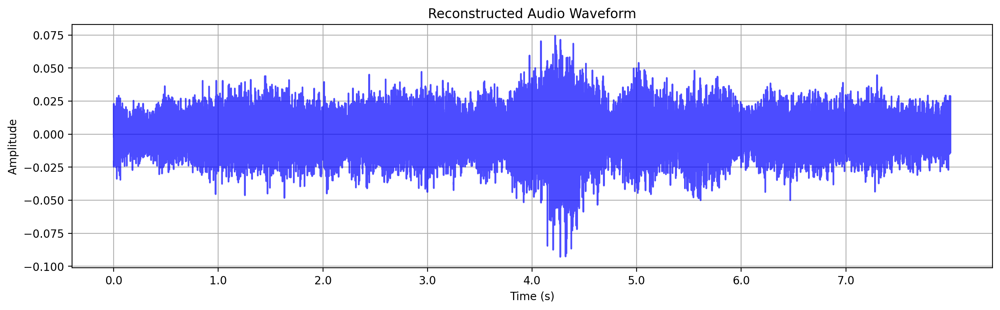

In [ ]:
audio_plot(pred_audio, sr, 'blue', 'Reconstructed Audio Waveform')

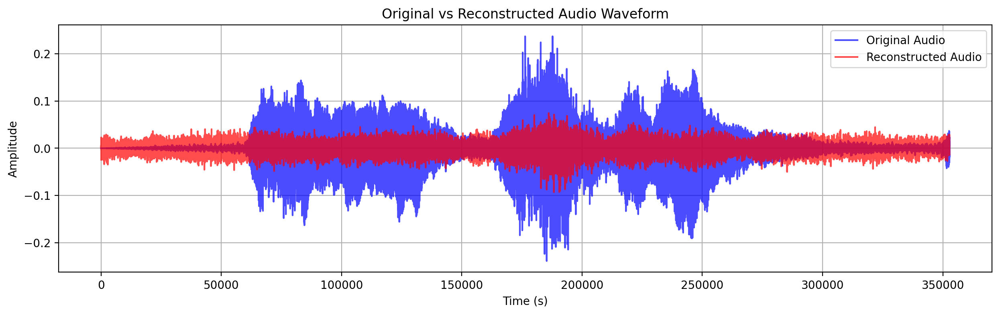

In [ ]:
plt.figure(figsize=(15, 4))
plt.plot(audio, color = 'blue', alpha = 0.7, label = 'Original Audio')
plt.plot(pred_audio, color = 'red', alpha = 0.7, label = 'Reconstructed Audio')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Original vs Reconstructed Audio Waveform')
plt.grid()
plt.legend()
plt.show()